In [1]:
#!pip install jieba

In [2]:
#!pip install wordcloud

In [3]:
#!pip install sklearn

In [11]:
#!pip install requests

In [1]:
import pandas as pd
import requests
import time
import json
import jieba
import re
import jieba.analyse
import numpy as np
from PIL import Image
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import logging
import random
%autosave 120

Autosaving every 120 seconds


In [2]:
#顯示所有列
pd.set_option('display.max_columns', None)
#顯示所有行
pd.set_option('display.max_rows', None)

pd.set_option("display.max_colwidth",1000)

# <font color = purple> Dcard標題 </font>

### 東吳 https://www.dcard.tw/service/api/v2/forums/scu/posts?popular=true&limit=30&before=238959051

In [21]:
url = 'https://www.dcard.tw/service/api/v2/forums/scu/posts?limit=10'

In [22]:
alldata = []
last_article = ''
url = 'https://www.dcard.tw/service/api/v2/forums/scu/posts?'
headers = {'user-agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/101.0.4951.67 Safari/537.36'}

In [23]:
i = 0
#j = 1
article = []
limit = 100
for i in range(20):
    #j=i-1
    #limit = random.randrange(80,100+1)
    if i != 0:
        request_url = url + "limit="+str(limit) +'&before=' + str(last_article)
    else:
        request_url = url
    list_req = requests.get(request_url,headers = headers) 
    try:
        getdata = json.loads(list_req.text)
    except:
        print("error")
        print(limit)
        #last_article = article[j-1]
    alldata.extend(getdata)
    last_article = getdata[-1]['id']
    article.append(last_article)
    print(last_article)
    time.sleep(5)

239139922
239095453
239026864
238951510
238914893
238865729
238814267
238781395
238755798
238729134
238707784
238685303
238666711
238645224
238620974
238599679
238555694
238487905
238439769
238372541


In [24]:
article #記錄爬過的文章末端id

[239139922,
 239095453,
 239026864,
 238951510,
 238914893,
 238865729,
 238814267,
 238781395,
 238755798,
 238729134,
 238707784,
 238685303,
 238666711,
 238645224,
 238620974,
 238599679,
 238555694,
 238487905,
 238439769,
 238372541]

In [25]:
df_alldata = pd.DataFrame(alldata)

In [27]:
df_alldata.head() #所有的標題

,id,title,excerpt,anonymousSchool,anonymousDepartment,pinned,forumId,replyId,createdAt,updatedAt,commentCount,likeCount,withNickname,tags,topics,meta,forumName,forumAlias,nsfw,gender,school,replyTitle,reportReason,mediaMeta,reactions,hidden,customStyle,isSuspiciousAccount,isModerator,layout,spoilerAlert,isSelectedPost,unsafe,enableNestedComment,totalCommentCount,withImages,withVideos,media,reportReasonText,supportedReactions,elapsedTime,excerptComments,edited,collectionCount,postAvatar,activityAvatar,verifiedBadge,memberType,department,enablePrivateMessage,hiddenOnPlatforms,downgradeLevel,link,hiddenWhenListBy
0,239148132,大二英文選課是自由選課嗎？,大二英文選課是自由選課嗎？我已經參加了大一英文的分班測驗。屆時初選是我要自己選還學校會幫我排？PS：我轉學生，大四修英文（二）,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-06-11T14:08:52.783Z,2022-06-11T14:08:52.783Z,2,1,False,[HIDE_THUMBNAIL],"[英文, 選課]",{'layout': 'classic'},東吳大學,scu,False,M,東吳大學,None,,[],"[{'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 1}]",False,None,False,False,classic,False,False,False,True,2,False,False,[],,None,3219,[],False,0,,,False,,NaN,NaN,NaN,NaN,NaN,NaN
1,239147816,關於溪通試 商業概論 蔡啟瑩,上次上課睡過頭沒上到，想問老師的期末考是要考什麼呢（；´༎ຶД༎ຶ`），謝謝各位！！！,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-06-11T13:34:06.047Z,2022-06-11T13:34:06.047Z,1,1,False,[HIDE_THUMBNAIL],"[考試, 大學, 東吳大學]",{'layout': 'classic'},東吳大學,scu,False,F,東吳大學,None,,[],"[{'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 1}]",False,None,False,False,classic,False,False,False,True,2,False,False,[],,None,5306,[],False,0,,,False,,NaN,NaN,NaN,NaN,NaN,NaN
2,239147409,溪通識二 道家經典選讀期末考,想請問有修鄭合修老師道家經典選讀的同學，老師期末考的作業題目是什麼，他上傳moodle的檔案並沒有題目,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-06-11T12:49:58.815Z,2022-06-11T12:49:58.815Z,2,0,False,[HIDE_THUMBNAIL],"[通識, 經典]",{'layout': 'classic'},東吳大學,scu,False,M,東吳大學,None,,[],[],False,None,False,False,classic,False,False,False,True,5,False,False,[],,None,7953,[],False,0,,,False,,NaN,NaN,NaN,NaN,NaN,NaN
3,239147379,英美刑推薦（已爬文）,想請問各位學長姐有推薦的老師嗎！有看過蠻多人推樓老師的，但是是不是每個老師都要小組報告，本人是外系生所以不太喜歡團體報告，再麻煩大家推薦謝謝（不刪文）,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-06-11T12:47:07.128Z,2022-06-11T12:47:07.128Z,2,4,False,[HIDE_THUMBNAIL],"[推薦, 考試, 法律系, 大學]",{'layout': 'classic'},東吳大學,scu,False,M,東吳大學,None,,[],"[{'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 4}]",False,None,False,False,classic,False,False,False,True,7,False,False,[],,None,8125,[],False,0,,,False,,NaN,NaN,NaN,NaN,NaN,NaN
4,239147312,交換留學申請,想請問在申請交換留學時，大家會偏向只申請一學期or一年？一學期似乎有點短，沒辦法體驗/學到太多，才剛熟悉環境時就要離開了；但一年真的能得到更多經驗嗎？此外如果只有去一學期的話，有沒有推薦上學期還是下學,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-06-11T12:38:53.058Z,2022-06-11T12:38:53.058Z,3,3,False,[HIDE_THUMBNAIL],[留學],{'layout': 'classic'},東吳大學,scu,False,F,東吳大學,None,,"[{'id': '980d7e03-cd95-4523-be3f-6de82f7aee64', 'url': 'https://sticker-assets.dcard.tw/images/793b04ec-eb2a-43f6-adcf-4a26ed28f8eb/orig.png', 'normalizedUrl': 'https://megapx.dcard.tw/v1/images/793b04ec-eb2a-43f6-adcf-4a26ed28f8eb', 'thumbnail': '', 'type': 'image/sticker', 'tags': ['IMAGE_NOT_AVAILABLE'], 'createdAt': '2022-06-11T12:38:53.058Z', 'updatedAt': '2022-06-11T12:38:53.058Z', 'width': 512, 'height': 512}]","[{'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 3}]",False,None,False,False,classic,False,False,False,True,6,True,False,[],,None,8619,[],False,0,,,False,,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
type(df_alldata)

In [ ]:
id = list(df_alldata['id'])

In [ ]:
id[-5:]

In [ ]:
len(id) #文章數量

# <font color = purple> Dcard標題資料匯出成excel </font>

In [ ]:
df_alldata.to_excel(r'D:\DcardTitle.xlsx', sheet_name='DcardTitle', index=False)
%time

# <font color = purple> 文章內容 </font>

In [ ]:
alldata = []
for articleID in id[-5:]:
    last_comment = ''
    url = 'https://www.dcard.tw/service/api/v2/posts/'+ str(articleID) +'/comments'
    doit = True
    i=0
    while doit:
        if i != 0: # 判斷是否是第一次執行
            request_url = url +'?after='+ str(last_comment)
        else:
            request_url = url # 第一次執行，不須加上後方的before
        list_req = requests.get(request_url) # 請求
        #將整個網站的程式碼爬下來
        getdata = json.loads(list_req.content)
        if len(getdata) > 0:
            alldata.extend(getdata) # 將另一個陣列插在最後面
        else:
            doit = False
        last_comment = str(len(alldata)) # 取出最後一篇文章
        print(i)
        time.sleep(5)
        i+=1

In [ ]:
alldata = pd.DataFrame(alldata)
alldata

In [ ]:
alldata[["postId","createdAt","floor","content"]]

# <font color = purple> 將標題匯入為Excel </font>

In [41]:
%%time
fname = r'D:\DcardTitle.xlsx'
rlog = pd.read_excel(fname)
print(type(rlog))
rlog.head()

<class 'pandas.core.frame.DataFrame'>
Wall time: 3.15 s


,id,title,excerpt,anonymousSchool,anonymousDepartment,pinned,forumId,replyId,createdAt,updatedAt,commentCount,likeCount,withNickname,tags,topics,meta,forumName,forumAlias,nsfw,gender,school,replyTitle,reportReason,mediaMeta,reactions,hidden,customStyle,isSuspiciousAccount,isModerator,layout,spoilerAlert,isSelectedPost,unsafe,enablePrivateMessage,enableNestedComment,totalCommentCount,withImages,withVideos,media,reportReasonText,supportedReactions,elapsedTime,excerptComments,edited,collectionCount,postAvatar,activityAvatar,verifiedBadge,memberType,department,link,downgradeLevel,hiddenWhenListBy,hiddenOnPlatforms
0,238975639,求上課連結🙏,請問財精二A的機率與統計上課連結是什麼？有人成功進去之前那個連結的嗎？,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-05-24T07:17:34.231Z,2022-05-24T07:17:48.530Z,0,0,False,[],[],"{'layout': 'classic', 'editedAt': '2022-05-24T07:17:48.536Z'}",東吳大學,scu,False,F,東吳大學,NaN,NaN,[],[],False,NaN,False,False,classic,False,False,False,0.0,True,0,False,False,[],NaN,NaN,2191,[],False,0,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
1,238975454,#詢問 沈莒達期末,請問有修課的同學，期末說的封面是加什麼封面？像論文那樣嗎？謝謝,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-05-24T06:54:51.389Z,2022-05-24T06:54:51.389Z,0,0,False,['HIDE_THUMBNAIL'],[],{'layout': 'classic'},東吳大學,scu,False,M,東吳大學,NaN,NaN,[],[],False,NaN,False,False,classic,False,False,False,NaN,True,0,False,False,[],NaN,NaN,3554,[],False,0,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
2,238974591,#轉 營隊到底要辦還是不辦？,NaN,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,238916088.0,2022-05-24T05:01:07.925Z,2022-05-24T05:01:07.925Z,1,4,False,[],"['營隊', '疫情', '確診', '停辦', '住宿']","{'layout': 'classic', 'crossPostId': 238916088}",東吳大學,scu,False,F,東吳大學,希望營隊負責人能看過來！,NaN,[],"[{'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 4}]",False,NaN,False,False,classic,False,False,False,NaN,True,2,False,False,[],NaN,NaN,10377,[],False,0,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
3,238973944,正式心理測驗～求大家幫忙(╥﹏╥),大家好！，我們是東吳大學心理學系修讀心理測驗的學生，目前正在進行「不同性別與文理組對解釋型態差異探討」的研究。嚴重缺乏男性樣本！！！（╥﹏╥），男女文理組同學麻煩都幫幫我們求求了，️此階段為正式問卷️,False,True,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-05-24T03:39:27.740Z,2022-05-24T03:40:11.416Z,2,2,False,['HIDE_THUMBNAIL'],['心理測驗'],"{'layout': 'classic', 'editedAt': '2022-05-24T03:40:11.420Z'}",東吳大學,scu,False,F,東吳大學,NaN,NaN,[],"[{'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 2}]",False,NaN,False,False,classic,False,False,False,0.0,True,2,False,False,[],NaN,NaN,15278,[],False,0,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN
4,238973180,我今年大一,我學測考這樣都可進來東吳了，你們不要在那邊囂張了，國文4，英文8，數學5，自然14，社會1，來分享你們的成績，話說有一次模擬考我考史上最好一次，國文11，英文7，數學8，自然15，社會4，我們班有一個,False,False,False,631f9943-9913-4e65-abaa-d6228a967329,NaN,2022-05-24T01:37:50.079Z,2022-05-24T01:37:50.079Z,60,16,False,[],"['大一', '考試', '疫情', '大學']",{'layout': 'classic'},東吳大學,scu,False,M,東吳大學,NaN,NaN,[],"[{'id': 'e8e6bc5d-41b0-4129-b134-97507523d7ff', 'count': 8}, {'id': 'aa0d425f-d530-4478-9a77-fe3aedc79eea', 'count': 4}, {'id': '286f599c-f86a-4932-82f0-f5a06f1eca03', 'count': 3}, {'id': '514c2569-fd53-4d9d-a415-bf0f88e7329f', 'count': 1}]",False,NaN,False,False,classic,False,False,False,NaN,True,90,False,False,[],NaN,NaN,22575,[],False,0,NaN,NaN,False,NaN,物理學系,NaN,NaN,NaN,NaN


# <font color = purple> 從文章標題篩選關鍵字 </font>

In [42]:
text = str(rlog['title'])
tags = jieba.analyse.extract_tags(text, topK=20)  
#topK 為返回幾個TF/IDF 權重最大的關鍵詞，默認值為20
print(tags)

['遠距', '確診', '室友', '東吳', '問卷', '累計', '什麼', '泉思', '作弊', '實體', '申請', '學校', '問題', '期中', '老師', '宿舍', '住宿生', '同學', '調查', '已徵到']


In [43]:
print(len(rlog['title'])) #資料筆數

6390


In [44]:
filt1 = rlog['title'].str.contains('遠距', na=False)
filt2 = rlog['title'].str.contains('實體', na=False)
 
id = rlog['id'].loc[filt1]
id = id.append(rlog['id'].loc[filt2])

In [45]:
title_id = []
title_id.extend(id) #重新排順序
title_id

[238961287,
 238956808,
 238947228,
 238943283,
 238931142,
 238931041,
 238930416,
 238926432,
 238923412,
 238921594,
 238921045,
 238920457,
 238915339,
 238903550,
 238884151,
 238883242,
 238879090,
 238875282,
 238872590,
 238857121,
 238855654,
 238846359,
 238844200,
 238843295,
 238837420,
 238834169,
 238831574,
 238825912,
 238817293,
 238812890,
 238809818,
 238804277,
 238798741,
 238793529,
 238792968,
 238786022,
 238780008,
 238778119,
 238775495,
 238773573,
 238772825,
 238772821,
 238770981,
 238768991,
 238764703,
 238760120,
 238758797,
 238757267,
 238757178,
 238755941,
 238755798,
 238754194,
 238750551,
 238748546,
 238738684,
 238732850,
 238723600,
 238722005,
 238720232,
 238719664,
 238718626,
 238717556,
 238711914,
 238703840,
 238703497,
 238688683,
 238687203,
 238685443,
 238685303,
 238683005,
 238679816,
 238677286,
 238961287,
 238956808,
 238947228,
 238943283,
 238931142,
 238931041,
 238930416,
 238926432,
 238961287,
 238956808,
 238947228,
 238

In [46]:
len(title_id) #篩選完遠距和實體關鍵字後的資料筆數

688

In [47]:
for articleID in title_id[:5]: #前五筆ID
    print(articleID)

238961287
238956808
238947228
238943283
238931142


# <font color = purple> 爬取文章留言 </font>

In [54]:
def get(url, verbose=False, **kwargs):
    response = requests.get(url, **kwargs)
    if verbose:
        logging.info(response.url)
    return response.json()

In [55]:
def get_post_content(articleID):
    last_comment = ''
    comments_url = 'https://www.dcard.tw/service/api/v2/posts/'+ str(articleID) +'/comments'
    params = {}
    comments = []
    while True:
        _comments = get(comments_url, params=params, verbose=True)
        if len(_comments) == 0:
            break
        comments += _comments
        params['after'] = comments[-1]['floor']
    return comments

In [56]:
i = 0
dataF = pd.DataFrame()
for articleID in title_id[2:5] :
    print(articleID)
    comment = pd.DataFrame(get_post_content(articleID))
    dataF = dataF.append(comment)
    i += 1
    print(i)
    time.sleep(random.randint(20,22))
dataF

238947228
1
238943283
2
238931142
3


,id,anonymous,postId,createdAt,updatedAt,floor,content,likeCount,withNickname,hiddenByAuthor,meta,host,gender,school,department,reportReason,mediaMeta,currentMember,hidden,inReview,reportReasonText,isSuspiciousAccount,isModerator,doorplate,subCommentCount,badge,edited,postAvatar,activityAvatar,verifiedBadge,memberType,enablePrivateMessage
0,d45c8a0b-3fce-47af-8fae-dbd6467c926e,False,238947228,2022-05-21T02:48:56.971Z,2022-05-21T02:48:56.971Z,1,等系辦的通知吧？\n或是你可以先去問問你們班的助教探聽點風聲,0.0,False,False,{},False,F,東吳大學,會計學系,,[],False,False,False,,False,False,1,0,{},False,,,False,,NaN
1,1a8602ad-9ec9-4920-a97a-63ee06081d9d,False,238947228,2022-05-21T11:14:23.320Z,2022-05-21T11:14:23.320Z,2,我們教授的課程進度表上寫遠距 供參,1.0,False,False,{},False,F,東吳大學,會計學系,,[],False,False,False,,False,False,2,1,{},False,,,False,,NaN
0,907b2db0-bac4-42a2-acc9-ad37c607dc04,False,238943283,2022-05-20T13:19:31.886Z,2022-05-20T13:19:31.886Z,1,昨晚去操場有看到還是開放的喔,0.0,False,False,{},False,M,東吳大學,日本語文學系,,[],False,False,False,,False,False,1,0,{},False,,,False,,NaN
1,9b376b54-85fc-4ca3-9c0d-7aed3f23f1d5,True,238943283,2022-05-20T16:37:55.561Z,2022-05-20T16:37:55.561Z,2,都可以用,0.0,False,False,{},False,F,東吳大學,NaN,,[],False,False,False,,False,False,2,0,{},False,,,False,,NaN
2,84a30f88-7443-432b-b8fb-3e902432805c,True,238943283,2022-05-22T15:21:35.260Z,2022-05-22T15:21:35.260Z,3,想打球+1,0.0,False,False,{},False,M,東吳大學,NaN,,[],False,False,False,,False,False,3,0,{},False,,,False,,NaN
0,ee43d58d-ae05-494d-9706-036a39c6048d,True,238931142,2022-05-19T08:05:07.214Z,2022-05-19T08:05:07.214Z,1,中一C黃耀宸喊在,3.0,False,False,{},False,M,東吳大學,NaN,,[],False,False,False,,False,False,1,1,{},False,,,False,,NaN
1,de759905-4aab-4768-bd46-540ecccb882c,True,238931142,2022-05-19T08:07:23.395Z,2022-05-19T08:07:23.395Z,2,一天生2000字報告給您參考⋯⋯,1.0,False,False,{},False,M,東吳大學,NaN,,[],False,False,False,,False,False,2,0,{},False,,,False,,NaN
2,9e5efbfe-ddf5-4471-8970-6fc6701cf553,True,238931142,2022-05-19T08:17:52.434Z,2022-05-19T08:17:52.434Z,3,不用謝\nhttps://i.imgur.com/UeUHJ5Y.jpg,1.0,False,False,{},False,M,東吳大學,NaN,,"[{'id': '84abd928-1cb9-4201-9b09-0631091882eb', 'url': 'https://i.imgur.com/UeUHJ5Yl.jpg', 'normalizedUrl': 'https://i.imgur.com/UeUHJ5Yl.jpg', 'thumbnail': 'https://i.imgur.com/UeUHJ5Yl.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-19T08:17:52.434Z', 'updatedAt': '2022-05-19T08:17:52.434Z', 'width': 925, 'height': 2000}, {'id': '84abd928-1cb9-4201-9b09-0631091882eb', 'url': 'https://i.imgur.com/UeUHJ5Y.jpg', 'normalizedUrl': 'https://imgur.com/UeUHJ5Y', 'thumbnail': 'https://i.imgur.com/UeUHJ5Yl.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-19T08:17:52.434Z', 'updatedAt': '2022-05-19T08:17:52.434Z', 'width': 925, 'height': 2000}]",False,False,False,,False,False,3,0,{},False,,,False,,NaN
3,d72e18ea-691a-49c6-bd6b-7ea2e49c36eb,False,238931142,2022-05-19T08:54:50.560Z,2022-05-19T08:54:50.560Z,4,一個月五千字英文報告或一萬字中文報告的在這🥹\n考試考三題兩個小時三千五百字的報告在這🥹🥹大家一起加油\nhttps://i.imgur.com/eHd5uPx.jpg,23.0,False,False,{},False,F,東吳大學,政治學系,,"[{'id': 'd03245ec-5819-4e3a-b42c-e02dd6162638', 'url': 'https://i.imgur.com/eHd5uPxl.jpg', 'normalizedUrl': 'https://i.imgur.com/eHd5uPxl.jpg', 'thumbnail': 'https://i.imgur.com/eHd5uPxl.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-19T08:54:50.560Z', 'updatedAt': '2022-05-19T08:54:50.560Z', 'width': 440, 'height': 440}, {'id': 'd03245ec-5819-4e3a-b42c-e02dd6162638', 'url': 'https://i.imgur.com/eHd5uPx.jpg', 'normalizedUrl': 'https://imgur.com/eHd5uPx', 'thumbnail': 'https://i.imgur.com/eHd5uPxl.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-19T08:54:50.560Z', 'updatedAt': '2022-05-19T08:54:50.560Z', 'width': 440, 'height': 440}]",False,False,False,,False,False,4,4,{},False,,,False,,NaN
4,38cf7f34-34b2-4eac-8ba2-cfb03e0cab04,True,238931142,2022-05-19T08:56:47.895Z,2022-05-19T08:56:47.895Z,5,逃掉恆嵩沒逃掉教程跟其他老師，我要死了,0.0,False,False,{},False,F,東吳大學,NaN,,[],False,False,False,,False,False,5,0,{},False,,,False,,NaN


# <font color = purple> 將文章留言匯出為Excel </font>

In [24]:
dataF.to_excel(r'DcardComments_.xlsx', sheet_name='DcardComments', index=False)
%time

Wall time: 0 ns


# <font color = purple> 匯入文章留言Excel檔 </font>

In [3]:
fname = r'DcardComments.xlsx'
df = pd.read_excel(fname)

In [4]:
df.head()

,id,anonymous,postId,createdAt,updatedAt,floor,content,likeCount,withNickname,hiddenByAuthor,meta,host,gender,school,reportReason,mediaMeta,currentMember,hidden,inReview,reportReasonText,isSuspiciousAccount,isModerator,doorplate,subCommentCount,enablePrivateMessage,edited,postAvatar,activityAvatar,verifiedBadge,memberType,department
0,c94cbfb4-ac63-4370-82eb-2dc2a6b2ea94,True,238956808,2022-05-22T05:58:39.361Z,2022-05-22T06:01:04.394Z,1,實體仔沒辦法省租屋冷氣錢森77囉\n啊跟你說的一樣，就是有這種人嘛\n實體仔們是不是只想去學校吹免費冷氣啊,119.0,False,False,{'editedAt': '2022-05-22T06:01:04.427Z'},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,1,6,0.0,False,NaN,NaN,False,NaN,NaN
1,7936d1fd-393a-435d-a7c8-00d71db8d4a1,True,238956808,2022-05-22T06:00:34.237Z,2022-05-22T06:00:34.237Z,2,看你在那邊亂生氣 我只覺得好好笑😆,201.0,False,False,{},False,F,東吳大學,NaN,[],False,False,False,NaN,False,False,2,1,NaN,False,NaN,NaN,False,NaN,NaN
2,8a096931-934e-4080-a6a1-1fe06d5a9e6e,True,238956808,2022-05-22T06:02:16.240Z,2022-05-22T06:02:16.240Z,3,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,364.0,False,False,{},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,3,10,NaN,False,NaN,NaN,False,NaN,NaN
3,945edf25-94c3-48f3-8fab-c2f7d0776a4e,True,238956808,2022-05-22T06:02:16.767Z,2022-05-22T06:06:17.127Z,4,你才不要當那種惹人厭的實體仔吧🤪🥹\n就是有你這種人整天在開戰開戰\n情商要再加油餒\n\nhttps://i.imgur.com/6nFzkH1.jpg,21.0,False,False,{'editedAt': '2022-05-22T06:06:17.130Z'},False,F,東吳大學,NaN,"[{'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1l.jpg', 'normalizedUrl': 'https://i.imgur.com/6nFzkH1l.jpg', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/thumbnail', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}, {'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1.jpg', 'normalizedUrl': 'https://imgur.com/6nFzkH1', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/imgur', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}]",False,False,False,NaN,False,False,4,0,0.0,False,NaN,NaN,False,NaN,NaN
4,a2274b17-9793-4f9f-a299-391d759123b0,True,238956808,2022-05-22T06:14:31.657Z,2022-05-22T06:14:31.657Z,5,抱怨的我看都是實體仔吧\n我遠距仔是覺得很讚啊\n省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾\nhttps://i.imgur.com/QeqArUm.jpg,37.0,False,False,{},False,M,東吳大學,NaN,"[{'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUml.jpg', 'normalizedUrl': 'https://i.imgur.com/QeqArUml.jpg', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}, {'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUm.jpg', 'normalizedUrl': 'https://imgur.com/QeqArUm', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}]",False,False,False,NaN,False,False,5,1,NaN,False,NaN,NaN,False,NaN,NaN


In [5]:
df = df.drop(["id"], axis=1)##把原本ID去掉

In [6]:
df.rename(columns={'postId': 'id'}, inplace=True)

In [7]:
df.head()

,anonymous,id,createdAt,updatedAt,floor,content,likeCount,withNickname,hiddenByAuthor,meta,host,gender,school,reportReason,mediaMeta,currentMember,hidden,inReview,reportReasonText,isSuspiciousAccount,isModerator,doorplate,subCommentCount,enablePrivateMessage,edited,postAvatar,activityAvatar,verifiedBadge,memberType,department
0,True,238956808,2022-05-22T05:58:39.361Z,2022-05-22T06:01:04.394Z,1,實體仔沒辦法省租屋冷氣錢森77囉\n啊跟你說的一樣，就是有這種人嘛\n實體仔們是不是只想去學校吹免費冷氣啊,119.0,False,False,{'editedAt': '2022-05-22T06:01:04.427Z'},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,1,6,0.0,False,NaN,NaN,False,NaN,NaN
1,True,238956808,2022-05-22T06:00:34.237Z,2022-05-22T06:00:34.237Z,2,看你在那邊亂生氣 我只覺得好好笑😆,201.0,False,False,{},False,F,東吳大學,NaN,[],False,False,False,NaN,False,False,2,1,NaN,False,NaN,NaN,False,NaN,NaN
2,True,238956808,2022-05-22T06:02:16.240Z,2022-05-22T06:02:16.240Z,3,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,364.0,False,False,{},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,3,10,NaN,False,NaN,NaN,False,NaN,NaN
3,True,238956808,2022-05-22T06:02:16.767Z,2022-05-22T06:06:17.127Z,4,你才不要當那種惹人厭的實體仔吧🤪🥹\n就是有你這種人整天在開戰開戰\n情商要再加油餒\n\nhttps://i.imgur.com/6nFzkH1.jpg,21.0,False,False,{'editedAt': '2022-05-22T06:06:17.130Z'},False,F,東吳大學,NaN,"[{'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1l.jpg', 'normalizedUrl': 'https://i.imgur.com/6nFzkH1l.jpg', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/thumbnail', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}, {'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1.jpg', 'normalizedUrl': 'https://imgur.com/6nFzkH1', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/imgur', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}]",False,False,False,NaN,False,False,4,0,0.0,False,NaN,NaN,False,NaN,NaN
4,True,238956808,2022-05-22T06:14:31.657Z,2022-05-22T06:14:31.657Z,5,抱怨的我看都是實體仔吧\n我遠距仔是覺得很讚啊\n省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾\nhttps://i.imgur.com/QeqArUm.jpg,37.0,False,False,{},False,M,東吳大學,NaN,"[{'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUml.jpg', 'normalizedUrl': 'https://i.imgur.com/QeqArUml.jpg', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}, {'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUm.jpg', 'normalizedUrl': 'https://imgur.com/QeqArUm', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}]",False,False,False,NaN,False,False,5,1,NaN,False,NaN,NaN,False,NaN,NaN


# <font color = purple> 清理空欄位以及停用詞 </font>

In [8]:
df['content'] = df['content'].str.replace('\n','')##把換行符號清理
df['content'] = df['content'].str.replace('https://i.imgur.com/','')##因為留言很多人會貼圖片，所以把網址的部分刪掉
df['content'] = df['content'].str.replace('https://','')
df['content'] = df['content'].str.replace('.jpg','')

In [9]:
df = df[df['content'].notna()]##清理空值

In [10]:
df = df.drop_duplicates(subset=['content'])##清理重複值

In [11]:
df.reset_index(inplace=True, drop=False)##重設index
df = df.drop(["index"], axis=1)

In [12]:
df.head()

,anonymous,id,createdAt,updatedAt,floor,content,likeCount,withNickname,hiddenByAuthor,meta,host,gender,school,reportReason,mediaMeta,currentMember,hidden,inReview,reportReasonText,isSuspiciousAccount,isModerator,doorplate,subCommentCount,enablePrivateMessage,edited,postAvatar,activityAvatar,verifiedBadge,memberType,department
0,True,238956808,2022-05-22T05:58:39.361Z,2022-05-22T06:01:04.394Z,1,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,119.0,False,False,{'editedAt': '2022-05-22T06:01:04.427Z'},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,1,6,0.0,False,NaN,NaN,False,NaN,NaN
1,True,238956808,2022-05-22T06:00:34.237Z,2022-05-22T06:00:34.237Z,2,看你在那邊亂生氣 我只覺得好好笑😆,201.0,False,False,{},False,F,東吳大學,NaN,[],False,False,False,NaN,False,False,2,1,NaN,False,NaN,NaN,False,NaN,NaN
2,True,238956808,2022-05-22T06:02:16.240Z,2022-05-22T06:02:16.240Z,3,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,364.0,False,False,{},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,3,10,NaN,False,NaN,NaN,False,NaN,NaN
3,True,238956808,2022-05-22T06:02:16.767Z,2022-05-22T06:06:17.127Z,4,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,21.0,False,False,{'editedAt': '2022-05-22T06:06:17.130Z'},False,F,東吳大學,NaN,"[{'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1l.jpg', 'normalizedUrl': 'https://i.imgur.com/6nFzkH1l.jpg', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/thumbnail', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}, {'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1.jpg', 'normalizedUrl': 'https://imgur.com/6nFzkH1', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/imgur', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}]",False,False,False,NaN,False,False,4,0,0.0,False,NaN,NaN,False,NaN,NaN
4,True,238956808,2022-05-22T06:14:31.657Z,2022-05-22T06:14:31.657Z,5,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,37.0,False,False,{},False,M,東吳大學,NaN,"[{'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUml.jpg', 'normalizedUrl': 'https://i.imgur.com/QeqArUml.jpg', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}, {'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUm.jpg', 'normalizedUrl': 'https://imgur.com/QeqArUm', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}]",False,False,False,NaN,False,False,5,1,NaN,False,NaN,NaN,False,NaN,NaN


# <font color = purple> 分詞 </font>

In [13]:
def cut_word(param_df) :##做分詞
    sentence = param_df['content']
    words = list(jieba.cut(sentence))
    return " ".join(words)

In [14]:
def cut_words(param) :##做分詞
    sentence = param
    words = list(jieba.cut(sentence))
    return words

In [15]:
df.head()

,anonymous,id,createdAt,updatedAt,floor,content,likeCount,withNickname,hiddenByAuthor,meta,host,gender,school,reportReason,mediaMeta,currentMember,hidden,inReview,reportReasonText,isSuspiciousAccount,isModerator,doorplate,subCommentCount,enablePrivateMessage,edited,postAvatar,activityAvatar,verifiedBadge,memberType,department
0,True,238956808,2022-05-22T05:58:39.361Z,2022-05-22T06:01:04.394Z,1,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,119.0,False,False,{'editedAt': '2022-05-22T06:01:04.427Z'},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,1,6,0.0,False,NaN,NaN,False,NaN,NaN
1,True,238956808,2022-05-22T06:00:34.237Z,2022-05-22T06:00:34.237Z,2,看你在那邊亂生氣 我只覺得好好笑😆,201.0,False,False,{},False,F,東吳大學,NaN,[],False,False,False,NaN,False,False,2,1,NaN,False,NaN,NaN,False,NaN,NaN
2,True,238956808,2022-05-22T06:02:16.240Z,2022-05-22T06:02:16.240Z,3,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,364.0,False,False,{},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,3,10,NaN,False,NaN,NaN,False,NaN,NaN
3,True,238956808,2022-05-22T06:02:16.767Z,2022-05-22T06:06:17.127Z,4,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,21.0,False,False,{'editedAt': '2022-05-22T06:06:17.130Z'},False,F,東吳大學,NaN,"[{'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1l.jpg', 'normalizedUrl': 'https://i.imgur.com/6nFzkH1l.jpg', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/thumbnail', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}, {'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1.jpg', 'normalizedUrl': 'https://imgur.com/6nFzkH1', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/imgur', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}]",False,False,False,NaN,False,False,4,0,0.0,False,NaN,NaN,False,NaN,NaN
4,True,238956808,2022-05-22T06:14:31.657Z,2022-05-22T06:14:31.657Z,5,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,37.0,False,False,{},False,M,東吳大學,NaN,"[{'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUml.jpg', 'normalizedUrl': 'https://i.imgur.com/QeqArUml.jpg', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}, {'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUm.jpg', 'normalizedUrl': 'https://imgur.com/QeqArUm', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}]",False,False,False,NaN,False,False,5,1,NaN,False,NaN,NaN,False,NaN,NaN


In [16]:
with open('stopword.txt', 'r', encoding='utf8') as f:  #stopword.txt = 停用詞表
    stops = f.read().split('\n') 

In [17]:
df['words'] = df.apply(cut_word, axis = 1)##把分好詞的內容加進dataFrame

Building prefix dict from the default dictionary ...
Loading model from cache C:\Users\User\AppData\Local\Temp\jieba.cache
Loading model cost 0.685 seconds.
Prefix dict has been built successfully.


In [18]:
df = pd.concat([df, pd.DataFrame(columns = ['StopWord'])], sort=False)

In [19]:
##把分好詞的字做停用詞
num = 0
for i in df['content'] : 
    your_words = cut_words(i)
    words_filtered = ' '.join([word for word in your_words if word not in stops])
    df['StopWord'][num] = "".join(words_filtered)
    num += 1

<ipython-input-19-d5d6183f4fc0>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['StopWord'][num] = "".join(words_filtered)


In [20]:
df

,anonymous,id,createdAt,updatedAt,floor,content,likeCount,withNickname,hiddenByAuthor,meta,host,gender,school,reportReason,mediaMeta,currentMember,hidden,inReview,reportReasonText,isSuspiciousAccount,isModerator,doorplate,subCommentCount,enablePrivateMessage,edited,postAvatar,activityAvatar,verifiedBadge,memberType,department,words,StopWord
0,True,238956808.0,2022-05-22T05:58:39.361Z,2022-05-22T06:01:04.394Z,1.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,119.0,False,False,{'editedAt': '2022-05-22T06:01:04.427Z'},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,1.0,6.0,0.0,False,NaN,NaN,False,NaN,NaN,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣
1,True,238956808.0,2022-05-22T06:00:34.237Z,2022-05-22T06:00:34.237Z,2.0,看你在那邊亂生氣 我只覺得好好笑😆,201.0,False,False,{},False,F,東吳大學,NaN,[],False,False,False,NaN,False,False,2.0,1.0,NaN,False,NaN,NaN,False,NaN,NaN,看 你 在 那邊 亂 生氣 我 只 覺得 好好笑 😆,亂 生氣 覺得 好好笑 😆
2,True,238956808.0,2022-05-22T06:02:16.240Z,2022-05-22T06:02:16.240Z,3.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,364.0,False,False,{},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,3.0,10.0,NaN,False,NaN,NaN,False,NaN,NaN,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 喔 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽
3,True,238956808.0,2022-05-22T06:02:16.767Z,2022-05-22T06:06:17.127Z,4.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,21.0,False,False,{'editedAt': '2022-05-22T06:06:17.130Z'},False,F,東吳大學,NaN,"[{'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1l.jpg', 'normalizedUrl': 'https://i.imgur.com/6nFzkH1l.jpg', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/thumbnail', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}, {'id': '680208fb-2c70-4f52-bd20-2b34015d0186', 'url': 'https://i.imgur.com/6nFzkH1.jpg', 'normalizedUrl': 'https://imgur.com/6nFzkH1', 'thumbnail': 'https://i.imgur.com/6nFzkH1l.jpg', 'type': 'image/imgur', 'tags': ['ANNOTATED'], 'createdAt': '2022-05-22T06:06:17.127Z', 'updatedAt': '2022-05-22T06:06:17.127Z', 'width': 1080, 'height': 1080}]",False,False,False,NaN,False,False,4.0,0.0,0.0,False,NaN,NaN,False,NaN,NaN,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1
4,True,238956808.0,2022-05-22T06:14:31.657Z,2022-05-22T06:14:31.657Z,5.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,37.0,False,False,{},False,M,東吳大學,NaN,"[{'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUml.jpg', 'normalizedUrl': 'https://i.imgur.com/QeqArUml.jpg', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/thumbnail', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}, {'id': 'e6c3f3d0-5b23-46cd-8ead-dabae55d7b95', 'url': 'https://i.imgur.com/QeqArUm.jpg', 'normalizedUrl': 'https://imgur.com/QeqArUm', 'thumbnail': 'https://i.imgur.com/QeqArUml.jpg', 'type': 'image/imgur', 'tags': [], 'createdAt': '2022-05-22T06:14:31.657Z', 'updatedAt': '2022-05-22T06:14:31.657Z', 'width': 2607, 'height': 1296}]",False,False,False,NaN,False,False,5.0,1.0,NaN,False,NaN,NaN,False,NaN,NaN,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm
5,True,238956808.0,2022-05-22T06:17:38.553Z,2022-05-22T06:17:38.553Z,6.0,啊是只有你一個人繳錢學校資源用不到？還是遠距的人繳的錢比較少？怕被罵改遠距就更好笑了，先去看之前校方對學生的態度好嗎？跟之前刪文的一樣，實體派狂熱份子出來講話都不帶腦的= =你也在丟實體仔的臉知道嗎？,13.0,False,False,{},False,M,東吳大學,NaN,[],False,False,False,NaN,False,False,6.0,0.0,NaN,False,NaN,NaN,False,NaN,NaN,啊 是 只有 你 一個 人 繳錢 學校 資源 用 不到 ？ 還是 遠距 的 人繳 的 錢 比 較 少 ？ 怕 被 罵 改遠 距 就 更好 笑 了 ， 先去 看 之前 校方 對學生 的 態度 好 嗎 ？ 跟 之前 刪文 的 一樣 ， 實體 派 狂熱 份子 出來 講話 都 不 帶腦 的 = = 你 也 在 丟實體 仔 的 臉 知道 嗎 ？,一個 繳錢 學校 資源 不到 遠距 人繳 錢 少 怕 罵 改遠 更好 笑 先去 之前 校方 對學生 態度 之前 刪文 實體 派 狂熱 份子 講話 帶腦 = = 

# <font color = purple> 關鍵字 </font>

In [21]:
df = pd.concat([df, pd.DataFrame(columns = ['rank'])], sort=False)

In [22]:
##把每則留言提取關鍵字 並放入DataFrame裡
num = 0
for i in df['content'] : 
    list = []
    for x, w in jieba.analyse.textrank(i, withWeight=True) :
        list += x + " "
    df['rank'][num] = "".join(list)
    num += 1

<ipython-input-22-f39ea000e8b5>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['rank'][num] = "".join(list)


In [23]:
df = df[['id', 'content', 'rank', 'words', 'StopWord']]##取出我們要用的內容
df.head(100)

,id,content,rank,words,StopWord
0,238956808.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,冷氣 租屋 法省 沒辦 實體 學校 免費,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣
1,238956808.0,看你在那邊亂生氣 我只覺得好好笑😆,,看 你 在 那邊 亂 生氣 我 只 覺得 好好笑 😆,亂 生氣 覺得 好好笑 😆
2,238956808.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,變好 精神 上課,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 喔 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽
3,238956808.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,開戰 情商 加油,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1
4,238956808.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,課邊 喝茶,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm
5,238956808.0,啊是只有你一個人繳錢學校資源用不到？還是遠距的人繳的錢比較少？怕被罵改遠距就更好笑了，先去看之前校方對學生的態度好嗎？跟之前刪文的一樣，實體派狂熱份子出來講話都不帶腦的= =你也在丟實體仔的臉知道嗎？,實體 不到 資源 繳錢 學校 校方 體仔 態度 知道 學生 出來 份子 刪文 遠距,啊 是 只有 你 一個 人 繳錢 學校 資源 用 不到 ？ 還是 遠距 的 人繳 的 錢 比 較 少 ？ 怕 被 罵 改遠 距 就 更好 笑 了 ， 先去 看 之前 校方 對學生 的 態度 好 嗎 ？ 跟 之前 刪文 的 一樣 ， 實體 派 狂熱 份子 出來 講話 都 不 帶腦 的 = = 你 也 在 丟實體 仔 的 臉 知道 嗎 ？,一個 繳錢 學校 資源 不到 遠距 人繳 錢 少 怕 罵 改遠 更好 笑 先去 之前 校方 對學生 態度 之前 刪文 實體 派 狂熱 份子 講話 帶腦 = = 丟實體 仔 臉 知道
6,238956808.0,哪裡一堆,,哪裡 一堆,一堆
7,238956808.0,n96ts9P,,n96ts9P,n96ts9P
8,238956808.0,實體仔下去洗洗睡啦 不要再發廢文了🤭,洗洗 實體,實體 仔 下去 洗洗 睡 啦 不要 再 發廢文 了 🤭,實體 仔 下去 洗洗 睡 不要 發廢文 🤭
9,238956808.0,我不想遠距是因為想女朋友ㄌ🥲🥲🥲只是純粹想在大學最後ㄉ時間好好陪她而已🥲🥲🥲,距是 時間 大學 不想 女朋友,我 不想 遠距 是 因為 想 女朋友 ㄌ 🥲 🥲 🥲 只是 純粹 想 在 大學 最 後 ㄉ 時間 好好 陪 她 而已 🥲 🥲 🥲,不想 遠距 想 女朋友 ㄌ 🥲 🥲 🥲 純粹 想 大學 ㄉ 時間 好好 陪 🥲 🥲 🥲


# <font color = purple>TF/IDF 關鍵字 </font>

In [85]:
text = str(df['StopWord'])##從StopWord計算TFIDF
tags = jieba.analyse.extract_tags(text, topK=20)  
#topK 為返回幾個TF/IDF 權重最大的關鍵詞，默認值為20
print(tags)
#for x, w in jieba.analyse.textrank(text, withWeight=True) :
#    print('%s %s' % (x, w))

['實體', '遠距', '學校', '確診', '老師', '真的', '不會', '學生', '隔離', '現在', '一個', '沒有', '期中考', '問題', '考試', '應該', '覺得', '不要', '同學', '防疫']


In [86]:
text = str(df['rank'])##從關鍵字算TFIDF
tags = jieba.analyse.extract_tags(text, topK=10)  
#topK 為返回幾個TF/IDF 權重最大的關鍵詞，默認值為20
print(tags)

['學校', '實體', '遠距', '確診', '沒有', '老師', '隔離', '學生', '上課', '覺得']


In [34]:
##把關鍵詞取出來放入list裡
term = []
for i in df['rank'] :
    term.extend(i.split())

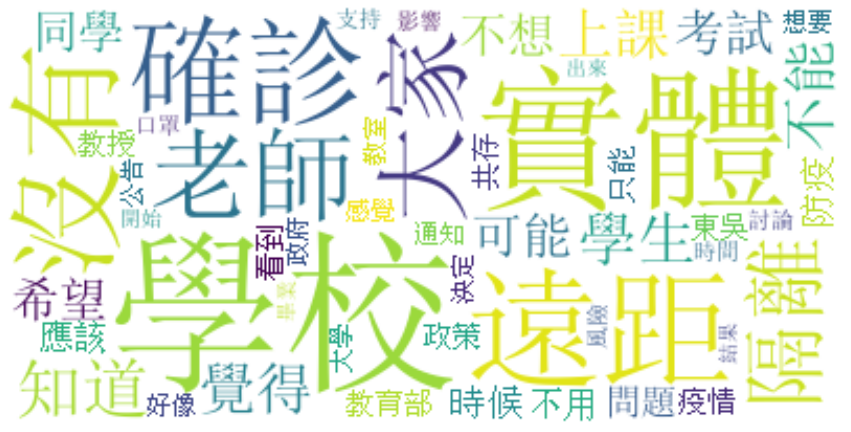

In [35]:
##使用關鍵字畫出文字雲
wordcloud = WordCloud(background_color="white", max_words=50, font_path="simsun.ttf")  ##做中文時務必加上字形檔
wordcloud.generate_from_frequencies(frequencies=Counter(term))
plt.figure(figsize=(15,15))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

# <font color = purple> 分類 </font>

In [3]:
from sklearn import metrics

In [4]:
fname = r'Data.xlsx'
df = pd.read_excel(fname)

In [5]:
df.head(20)

,id,faction,faction_id,content,rank,words,StopWord
0,238956808,遠距,1.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,冷氣 租屋 法省 沒辦 實體 學校 免費,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣
1,238956808,其他,2.0,看你在那邊亂生氣 我只覺得好好笑😆,NaN,看 你 在 那邊 亂 生氣 我 只 覺得 好好笑 😆,亂 生氣 覺得 好好笑 😆
2,238956808,遠距,1.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,變好 精神 上課,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽
3,238956808,遠距,1.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,開戰 情商 加油,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1
4,238956808,遠距,1.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,課邊 喝茶,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm
5,238956808,其他,2.0,啊是只有你一個人繳錢學校資源用不到？還是遠距的人繳的錢比較少？怕被罵改遠距就更好笑了，先去看之前校方對學生的態度好嗎？跟之前刪文的一樣，實體派狂熱份子出來講話都不帶腦的= =你也在丟實體仔的臉知道嗎？,實體 不到 資源 繳錢 學校 校方 體仔 態度 知道 學生 出來 份子 刪文 遠距,啊 是 只有 你 一個 人 繳錢 學校 資源 用 不到 ？ 還是 遠距 的 人繳 的 錢 比 較 少 ？ 怕 被 罵 改遠 距 就 更好 笑 了 ， 先去 看 之前 校方 對學生 的 態度 好 嗎 ？ 跟 之前 刪文 的 一樣 ， 實體 派 狂熱 份子 出來 講話 都 不 帶腦 的 = = 你 也 在 丟實體 仔 的 臉 知道 嗎 ？,繳錢 學校 資源 不到 遠距 人繳 錢 少 怕 罵 改遠 更好 笑 先去 之前 校方 對學生 態度 之前 刪文 實體 派 狂熱 份子 講話 帶腦 = = 丟實體 仔 臉 知道
6,238956808,其他,2.0,哪裡一堆,NaN,哪裡 一堆,一堆
7,238956808,其他,2.0,n96ts9P,NaN,n96ts9P,n96ts9P
8,238956808,遠距,1.0,實體仔下去洗洗睡啦 不要再發廢文了🤭,洗洗 實體,實體 仔 下去 洗洗 睡 啦 不要 再 發廢文 了 🤭,實體 仔 下去 洗洗 睡 不要 發廢文 🤭
9,238956808,實體,0.0,我不想遠距是因為想女朋友ㄌ🥲🥲🥲只是純粹想在大學最後ㄉ時間好好陪她而已🥲🥲🥲,距是 時間 大學 不想 女朋友,我 不想 遠距 是 因為 想 女朋友 ㄌ 🥲 🥲 🥲 只是 純粹 想 在 大學 最 後 ㄉ 時間 好好 陪 她 而已 🥲 🥲 🥲,不想 遠距 想 女朋友 ㄌ 🥲 🥲 🥲 純粹 想 大學 ㄉ 時間 好好 陪 🥲 🥲 🥲


In [6]:
d = {'faction':df[ 'faction'].value_counts().index, 'count': df['faction'].value_counts()}
df_faction = pd.DataFrame(data=d).reset_index(drop=True)
df_faction

,faction,count
0,其他,1384
1,遠距,559
2,實體,203


Text(0.5, 0, '類別')

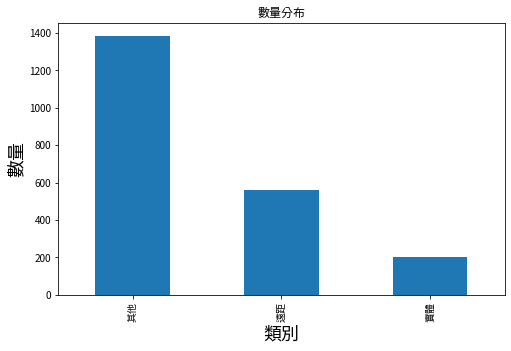

In [7]:
plt.rcParams['font.sans-serif'] = ['Taipei Sans TC Beta']
df_faction.plot(x='faction', y='count', kind='bar', legend=False, figsize=(8, 5))
plt.title("數量分布")
plt.ylabel('數量',fontsize=18)
plt.xlabel('類別',fontsize=18)

In [8]:
df = df[df['faction_id'] < 2.0]

In [9]:
df.head(20)

,id,faction,faction_id,content,rank,words,StopWord
0,238956808,遠距,1.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,冷氣 租屋 法省 沒辦 實體 學校 免費,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣
2,238956808,遠距,1.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,變好 精神 上課,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽
3,238956808,遠距,1.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,開戰 情商 加油,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1
4,238956808,遠距,1.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,課邊 喝茶,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm
8,238956808,遠距,1.0,實體仔下去洗洗睡啦 不要再發廢文了🤭,洗洗 實體,實體 仔 下去 洗洗 睡 啦 不要 再 發廢文 了 🤭,實體 仔 下去 洗洗 睡 不要 發廢文 🤭
9,238956808,實體,0.0,我不想遠距是因為想女朋友ㄌ🥲🥲🥲只是純粹想在大學最後ㄉ時間好好陪她而已🥲🥲🥲,距是 時間 大學 不想 女朋友,我 不想 遠距 是 因為 想 女朋友 ㄌ 🥲 🥲 🥲 只是 純粹 想 在 大學 最 後 ㄉ 時間 好好 陪 她 而已 🥲 🥲 🥲,不想 遠距 想 女朋友 ㄌ 🥲 🥲 🥲 純粹 想 大學 ㄉ 時間 好好 陪 🥲 🥲 🥲
11,238956808,遠距,1.0,遠距超讚啊,NaN,遠距 超 讚 啊,遠距 超 讚
14,238956808,遠距,1.0,遠距好爽喔 看你這樣我更爽 呵呵,NaN,遠距 好爽 喔 看 你 這樣 我 更爽 呵呵,遠距 好爽 更爽
19,238956808,遠距,1.0,實體仔有些也超歡啊像你( ･ᯅ･ ),超歡 實體,實體 仔 有些 也 超歡 啊 像 你 ( ･ ᯅ ･ ),實體 仔 超歡 ･ ᯅ ･
21,238956808,遠距,1.0,報告才是最爽的啊！輕鬆寫意分數又高，怎能不爽。,NaN,報告 才 是 最爽 的 啊 ！ 輕 鬆 寫 意 分 數 又 高 ， 怎能不 爽 。,報告 最爽 輕 鬆 寫 意 分 數 高 怎能不 爽


In [10]:
def make_label(df):
    df["sentiment"] = df["faction_id"].apply(lambda x: 1 if x>0 else 0)

In [11]:
make_label(df)

In [12]:
df

,id,faction,faction_id,content,rank,words,StopWord,sentiment
0,238956808,遠距,1.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,冷氣 租屋 法省 沒辦 實體 學校 免費,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣,1
2,238956808,遠距,1.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,變好 精神 上課,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽,1
3,238956808,遠距,1.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,開戰 情商 加油,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1,1
4,238956808,遠距,1.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,課邊 喝茶,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,1
8,238956808,遠距,1.0,實體仔下去洗洗睡啦 不要再發廢文了🤭,洗洗 實體,實體 仔 下去 洗洗 睡 啦 不要 再 發廢文 了 🤭,實體 仔 下去 洗洗 睡 不要 發廢文 🤭,1
9,238956808,實體,0.0,我不想遠距是因為想女朋友ㄌ🥲🥲🥲只是純粹想在大學最後ㄉ時間好好陪她而已🥲🥲🥲,距是 時間 大學 不想 女朋友,我 不想 遠距 是 因為 想 女朋友 ㄌ 🥲 🥲 🥲 只是 純粹 想 在 大學 最 後 ㄉ 時間 好好 陪 她 而已 🥲 🥲 🥲,不想 遠距 想 女朋友 ㄌ 🥲 🥲 🥲 純粹 想 大學 ㄉ 時間 好好 陪 🥲 🥲 🥲,0
11,238956808,遠距,1.0,遠距超讚啊,NaN,遠距 超 讚 啊,遠距 超 讚,1
14,238956808,遠距,1.0,遠距好爽喔 看你這樣我更爽 呵呵,NaN,遠距 好爽 喔 看 你 這樣 我 更爽 呵呵,遠距 好爽 更爽,1
19,238956808,遠距,1.0,實體仔有些也超歡啊像你( ･ᯅ･ ),超歡 實體,實體 仔 有些 也 超歡 啊 像 你 ( ･ ᯅ ･ ),實體 仔 超歡 ･ ᯅ ･,1
21,238956808,遠距,1.0,報告才是最爽的啊！輕鬆寫意分數又高，怎能不爽。,NaN,報告 才 是 最爽 的 啊 ！ 輕 鬆 寫 意 分 數 又 高 ， 怎能不 爽 。,報告 最爽 輕 鬆 寫 意 分 數 高 怎能不 爽,1


In [13]:
df ##0是實體,1是遠距

,id,faction,faction_id,content,rank,words,StopWord,sentiment
0,238956808,遠距,1.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,冷氣 租屋 法省 沒辦 實體 學校 免費,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣,1
2,238956808,遠距,1.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,變好 精神 上課,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽,1
3,238956808,遠距,1.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,開戰 情商 加油,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1,1
4,238956808,遠距,1.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,課邊 喝茶,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,1
8,238956808,遠距,1.0,實體仔下去洗洗睡啦 不要再發廢文了🤭,洗洗 實體,實體 仔 下去 洗洗 睡 啦 不要 再 發廢文 了 🤭,實體 仔 下去 洗洗 睡 不要 發廢文 🤭,1
9,238956808,實體,0.0,我不想遠距是因為想女朋友ㄌ🥲🥲🥲只是純粹想在大學最後ㄉ時間好好陪她而已🥲🥲🥲,距是 時間 大學 不想 女朋友,我 不想 遠距 是 因為 想 女朋友 ㄌ 🥲 🥲 🥲 只是 純粹 想 在 大學 最 後 ㄉ 時間 好好 陪 她 而已 🥲 🥲 🥲,不想 遠距 想 女朋友 ㄌ 🥲 🥲 🥲 純粹 想 大學 ㄉ 時間 好好 陪 🥲 🥲 🥲,0
11,238956808,遠距,1.0,遠距超讚啊,NaN,遠距 超 讚 啊,遠距 超 讚,1
14,238956808,遠距,1.0,遠距好爽喔 看你這樣我更爽 呵呵,NaN,遠距 好爽 喔 看 你 這樣 我 更爽 呵呵,遠距 好爽 更爽,1
19,238956808,遠距,1.0,實體仔有些也超歡啊像你( ･ᯅ･ ),超歡 實體,實體 仔 有些 也 超歡 啊 像 你 ( ･ ᯅ ･ ),實體 仔 超歡 ･ ᯅ ･,1
21,238956808,遠距,1.0,報告才是最爽的啊！輕鬆寫意分數又高，怎能不爽。,NaN,報告 才 是 最爽 的 啊 ！ 輕 鬆 寫 意 分 數 又 高 ， 怎能不 爽 。,報告 最爽 輕 鬆 寫 意 分 數 高 怎能不 爽,1


In [14]:
X = df[['content']]
y = df.sentiment

# <font color = purple> 情感分析 </font>

In [15]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer

In [16]:
X['cutted_comment'] = df[['StopWord']].values.astype('U')

<ipython-input-16-7f6c66072d7d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X['cutted_comment'] = df[['StopWord']].values.astype('U')


In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1)

In [18]:
X_train

,content,cutted_comment
597,說真的 我們班昨天通報確診者那附近就有人在吃東西（同一組）我覺得很正常 我們上課到那麼晚沒吃晚餐 餓了就想吃ㄚ但重點是 既然大家都怕在教室吃有染疫風險出了教室又沒空曠的地方那為什麼不遠距就好^_^偏要讓老師學生受苦受難罷課了喇^_^,說 真的 班 昨天 通報 確診者 附近 有人 吃 東西 （ 同一 組 ） 我覺 正常 課到 晚 沒 吃 晚餐 餓 想 吃 ㄚ 重點 怕 教室 吃 有染 疫風險 出 教室 沒空 曠 地方 那為 不遠 ^ ^ 偏要 老師 學生 受苦 受難 罷課 喇 ^ ^
1524,讚啦 人擠人大家一起來確診看看雙溪557 地餐人潮,讚 人擠 一起 確診 看看 雙溪 557 地餐 人潮
2136,我不想去學校然後被匡列然後隔離欸==不用被隔離的話當然實體遠距都沒差啊問題就是我為什麼要多一個被隔離的風險^ - ^,不想 去學 校然 匡 列然後隔 = = 不用 隔 話 實體 遠距 沒差 問題 我為 隔 風險 ^ - ^
488,作弊仔到哪都會作弊，有些教授會因為你遠距可能作弊而直接調高試卷難度當然也是有人實體還作弊還被抓到，導致全班之後考試難度增加,作弊 仔到 會 作弊 教授 會 遠 可能 作弊 直接 調高試 卷 難度 有人 實體還 作弊 還被 抓 導致 全班 之後考 試難度 增加
2078,如果是去1999反應呢？ 我們校內app的留言學校完全沒有要回欸😂,1999 反應 校內 app 留言 學校 完全 沒有 回 😂
1341,支持期中遠距,支持 期中 遠距
29,以後要發文前要標註是實體仔還是遠距仔來判斷都是哪些人在崩潰了，身為遠距仔的我只能說好爽喔😄,以後要 發文前 標 註 實 體 仔 遠 仔 判 斷 崩潰 身為 遠距 仔 只能 說 好爽 😄
304,今天中午前就開完防疫會議決定的啦，沒人託夢,今天 中午 前 開 完 防疫 會議 決定 沒人 託 夢
219,遠距到期末我就星爆,遠距 期末 星爆
1148,不想去學校+1,不想 學校 + 1


In [19]:
max_df = 0.8 # 在超過這一比例的文件中出現的關鍵詞（過於平凡），去除掉。
min_df = 3 # 在低於這一數量的文件中出現的關鍵詞（過於獨特），去除掉。

In [20]:
vect = CountVectorizer(max_df = max_df,
                       min_df = min_df,
                       token_pattern=u'(?u)\\b[^\\d\\W]\\w+\\b')

In [21]:
term_matrix = pd.DataFrame(vect.fit_transform(X_train.cutted_comment).toarray(), columns=vect.get_feature_names())

In [22]:
term_matrix.head()

,app,assets,b17,b3,dcard,images,orig,pcr,png,po,sticker,tw,一下,一半,一堂,一堆,一大堆,一天,一定,一次,一直,一起,一輩子,一點,上學,上次,上班,上課,下去,下禮,下降,不到,不去,不同,不好,不想,不敢,不會,不爽,不用,不能,不要,不遠,世界,中午,中心,主要,之前,乖乖,事情,互動,交通,人數,今天,代表,以前,以外,但學校,但現,住宿生,作弊,使用,保障,倒霉,做到,做好,停課,健康,傳染,傳染給,全校,全班,兩個,兩次,公告,公布,公平,共存,其他人,其實,再遠,冷氣,出門,到底,到校,刺激,剛剛,剛好,剩下,加上,加油,匡列,危險,原來,原因,原本,去年,反對,反應,反映,反正,受教權,口罩,只會,只能,可怕,可憐,可能,台北,台大,同一,同堂,同學,同意,同步,咳嗽,哈哈哈,問題,喜歡,單純,嚴重,回去,回學校,回家,回歸,在家,地方,地餐,坐等,城中,堅持,報告,增加,壓力,多數,大學,大學生,大部分,好像,好好,好爽,學校,學生,學習,學餐,完全,宣布,害怕,家中,家人,家裡,容易,宿舍,實體,尊重,小心,尤其,居家,工作,已經,希望,平常,幾乎,幾天,延期,延長,建議,影響,很多,很大,很怕,很爽,得到,必要,情況,想到,想問,想法,想要,意思,感冒,感染,感覺,感謝,態度,慢慢,應該,成效,成績,我會,我覺,打亂,打工,打算,承受,授課,接下,接受,接觸,措施,提出,擔心,支持,收到,改成,改遠,政府,政策,效果,效率,教學,教室,教授,教權,教育部,整天,文章,方式,方案,方法,旅館,日子,明天,明明,星期,昨天,是不是,時間,晚上,最近,會不會,會議,有人,朋友,期中,期中考,期待,期末,期末考,期間,未來,本來,東吳,東西,染疫,校內,校區,校方,校長,根本,框列,標準,樣子,機會,機率,權益,正常,正式,每個,每天,每次,比較,決定,沒事,沒人,沒差,沒有,沒錯,沒關,浪費,消息,清零,減少,準備,溝通,無法,無症,照樣,爆發,狀況,現在,理由,生活,用餐,申請,留言,畢典,畢業,畢業生,畢竟,當初,疫情,疫苗,病毒,白痴,監測,目前,直接,看來,看到,看看,真的,睡覺,知道,確定,確診,確診者,禮拜,租屋,管理,糾結,絕對,維持,線上,縣市,繼續,罷課,群聚,老實,老師,考完,考試,考量,肺炎,自主,自行,至少,舒服,薪水,處理,被匡列,被迫,要求,規定,覺得,解決,討論,設備,診者,認為,認真,說法,課程,調整,請問,謝謝,證明,讀書,變成,負擔,費用,贊成,起來,超爽,超過,越來,趕快,趨緩,足跡,距到,距離,身邊,身體,輕症,辦法,這是,這禮,這種,通勤,通知,週遠,遠距,遺症,避免,還在,還好,邏輯,那種,部分,配套,配套措施,重症,重要,重點,錄影,開放,開線,開遠,防疫,降低,隔壁,隔離,雙標,雙溪,離過,難道,需要,願意,風險,體育,高中,麻煩
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

### <font color = purple> 樸素貝葉斯（Multinomial naive bayes） </font>

In [55]:
from sklearn.naive_bayes import MultinomialNB
nb = MultinomialNB()

* Scikit-learn給我們提供了一個功能，叫做管道(pipeline)，可以方便解決這個問題。

* 它可以幫助我們，把這些順序工作連線起來，隱藏其中的功能順序關聯，從外部一次呼叫，就能完成順序定義的全部工作。

* 使用很簡單，我們就把 vect 和 nb 串聯起來，叫做pipe 

In [24]:
from sklearn.pipeline import make_pipeline
pipe = make_pipeline(vect, nb)

In [25]:
pipe.steps

[('countvectorizer',
  CountVectorizer(max_df=0.8, min_df=3, token_pattern='(?u)\\b[^\\d\\W]\\w+\\b')),
 ('multinomialnb', MultinomialNB())]

In [26]:
from sklearn.model_selection import cross_val_score
cross_val_score(pipe, X_train.cutted_comment, y_train, cv=5, scoring='accuracy').mean()

0.7105263157894737

In [27]:
pipe.fit(X_train.cutted_comment, y_train)

Pipeline(steps=[('countvectorizer',
                 CountVectorizer(max_df=0.8, min_df=3,
                                 token_pattern='(?u)\\b[^\\d\\W]\\w+\\b')),
                ('multinomialnb', MultinomialNB())])

In [28]:
X_train.shape

(570, 2)

In [29]:
y_train.shape

(570,)

In [30]:
#X_test.astype('U').valuesb

In [31]:
X_test

,content,cutted_comment
394,B4 原本一堆老師反對遠距說什麼遠距上課沒有人回應老師上課內容現在好了吧找自己麻煩,B4 原本 一堆 老師 反 遠 說 遠距 課 沒 有人 回應 老師 課內 容現 好了吧 找 麻煩
1988,現在實體的必要是什麼,現在 實體 必要
2074,溫馨提醒各位～防疫險記得買😊要回學校確診囉🥰,溫馨 提醒 ～ 防疫 險記 買 😊 回學校 確診 囉 🥰
1223,支持實體。,支持 實體
812,補助拿來幹嘛蓋笑死館喔自己不想辦法開源節流 財務出狀況反而要怪我們唸東吳==？倒果為因,補助 幹 蓋 笑 死館 不想 辦法 開源 節流 財務出 狀況 要怪 唸 東吳 = = 倒果
2026,爽啦 遠距仔下去,爽 遠距 仔 下去
1479,對啊像我們這種很孝順的為了家人的健康只好忍痛接受遠距離真的是千萬的不願意很難過sticker-assets.dcard.tw/images/181e0559-4dd7-4b10-a94f-b5319ba53718/orig.png,這種 孝順 家人 健康 只好 忍痛 接受 遠距離 真的 千萬 不願意 難過 sticker - assets . dcard . tw images 181e0559 - 4dd7 - 4b10 - a94f - b5319ba53718 orig . png
1485,雖然現在重症機率低但是我比較怕的是後遺症對身體的影響而且現在被政府匡列隔離好麻煩 只要班上有一個整個生活都受到影響..（我現在就在隔離中，真的是不隔不知道，ㄧ隔嚇一跳🥲）所以如果不需要這麼麻煩的隔離還有PCR 那我也可以實體上課,雖然現 重症 機率 低 怕 遺症 身體 影響 現在 政府 匡列 隔離 麻煩 班上 整個 生活 影響 .. （ 我現 隔 中 真的 隔 知道 ㄧ 隔嚇 跳 🥲 ） 需要 麻煩 隔離 PCR 實體 課
2004,東吳不愛我🥹,東吳 不愛我 🥹
164,東海也是⋯維大不要再躲貓貓了 他可能想要得第一（？,東海 ⋯ 維大 不要 躲 貓貓 可能 想要 第一 （


In [32]:
X_test.shape

(191, 2)

In [33]:
pipe.predict(X_test.cutted_comment.astype('U').values)

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0], dtype=int64)

In [34]:
y_pred = pipe.predict(X_test.cutted_comment)

* 模型準確率

In [35]:
metrics.accuracy_score(y_test, y_pred)

0.6596858638743456

* 混淆模型

In [36]:
metrics.confusion_matrix(y_test, y_pred)

array([[  9,  52],
       [ 13, 117]], dtype=int64)

### <font color = purple> 情緒分析</font>

In [37]:
faction_id_df = df[["faction","faction_id"]].drop_duplicates().sort_values('faction_id').reset_index(drop=True)
faction_to_id = dict(faction_id_df.values)
id_to_faction = dict(faction_id_df[['faction_id', 'faction']].values)
df.sample(100).head(100) #sample亂數抽DF內容

,id,faction,faction_id,content,rank,words,StopWord,sentiment
1979,238604016,遠距,1.0,B17-4 現在實名制都可以不掃了慢慢放寬了，還是你明天就不要帶口罩出門？這樣就可以馬上共存了,口罩 出門,B17 - 4 現在 實名制 都 可以 不掃 了 慢慢 放寬 了 ， 還是 你 明天 就 不要 帶 口罩 出門 ？ 這樣 就 可以 馬 上 共存 了,B17 - 4 現在 實名制 不掃 慢慢 放寬 明天 不要 帶 口罩 出門 馬 共存,1
150,238903550,實體,0.0,課程遠距 考試實體,考試 課程 實體,課程 遠距 考試 實體,課程 遠距 考試 實體,0
404,238775495,實體,0.0,以上年經驗遠距時期劍南路專車會停開,南路 專車 遠距 時期 經驗 停開,以上 年 經驗 遠距 時期 劍 南路 專車會 停開,年 經驗 遠距 時期 劍 南路 專車會 停開,0
1172,238604555,遠距,1.0,我現在在隔離，隔離完要自主管理，學校不準這期間到校，請問期中考是要怎麼辦…,自主 隔離 學校 不準 管理 到校,我現 在 在 隔離 ， 隔離 完要 自主 管理 ， 學校 不準 這期間 到校 ， 請問 期中考 是 要 怎麼 辦 …,我現 隔離 隔離 完要 自主 管理 學校 不準 這期間 到校 請問 期中考 辦 …,1
2084,238603628,遠距,1.0,讚 大家一起確診確起來,確起 確診 大家,讚 大家 一起 確診 確起 來,讚 一起 確診 確起,1
646,238718626,遠距,1.0,發生這種事一定是別的學校 畢竟東吳沒有校長,沒有 東吳 校長 學校,發生 這種 事 一定 是 別 的 學校 畢竟 東吳 沒有 校長,發生 這種 事 一定 學校 畢竟 東吳 沒有 校長,1
1532,238541097,遠距,1.0,大家不要忘記老師也有可能確診現在還可以吵要全部遠距還是課堂錄影如果老師確診就直接停課了,老師 確診 遠距 吵要 忘記 堂錄 可能 全部 大家 停課,大家 不要 忘記 老師 也 有 可能 確診 現在還 可以 吵要 全部 遠距 還是 課堂 錄影 如果 老師 確診 就 直接 停課 了,不要 忘記 老師 可能 確診 現在還 吵要 遠距 課堂 錄影 老師 確診 直接 停課,1
860,238642111,實體,0.0,我是支持共存實體但如果因為染疫被隔離不也是影響學生的受教權嗎？學校配套措施都還沒擬好就急著上路真的沒人能接受ㄉ,沒擬 教權 實體 影響 配套措施 學校 支持 共存 染疫 隔離 急著 上路 學生,我 是 支持 共存 實體 但 如果 因為 染疫 被 隔 離 不 也 是 影響 學生 的 受 教權 嗎 ？ 學校 配套措施 都 還沒擬 好 就 急 著 上路 真的 沒人能 接受 ㄉ,支持 共存 實體 染疫 隔 影響 學生 受 教權 學校 配套措施 還沒擬 急 上路 真的 沒人能 接受 ㄉ,0
2093,238597606,遠距,1.0,其實主要怕的不是重症，是後遺症,重症 遺症,其實 主要 怕 的 不是 重症 ， 是 後 遺症,其實 主要 怕 重症 遺症,1
2041,238603628,遠距,1.0,這也不能怪學校啊政策是教育部規定的，其他學校沒問題也是恢復實體乖乖去考試啦,政策 規定 學校 教育部 問題 不能,這也 不能 怪學校 啊 政策 是 教育部 規定 的 ， 其他 學校 沒 問題 也 是 恢 復 實體 乖乖 去 考試 啦,這也 不能 怪學校 政策 教育部 規定 學校 沒 問題 恢 復 實體 乖乖 考試,1


In [38]:
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
X_train, X_test, y_train, y_test = train_test_split(X['cutted_comment'], df['faction_id'], random_state = 0)
count_vect = CountVectorizer()
X_train_counts = count_vect.fit_transform(X_train)
tfidf_transformer = TfidfTransformer()
X_train_tfidf =tfidf_transformer.fit_transform(X_train_counts)
clf = MultinomialNB().fit(X_train_tfidf,y_train)

In [39]:
def myPredict(sec):
    format_sec=" ".join([w for w in list(jieba.cut(sec))])
    pred_cat_id=clf.predict(count_vect.transform([format_sec]))
    print(id_to_faction[pred_cat_id[0]])

In [40]:
myPredict("家裡有12歲以下小孩還有寵物還有沒打滿三劑的老人真的很不想把風險帶回家")

Building prefix dict from the default dictionary ...
Loading model from cache C:\Users\User\AppData\Local\Temp\jieba.cache
Loading model cost 0.674 seconds.
Prefix dict has been built successfully.


遠距


In [41]:
myPredict("支持實體但現在就是會被匡列學校也只說要自己跟教授解決不覺得就是在甩鍋嗎")

實體


In [42]:
myPredict("給想實體的你：如果到最後真的遠距了，麻煩你轉學。")

遠距


In [43]:
myPredict("世新也已經延到4/18了 連假完疫情真的會爆⋯不懂東吳執著的原因是什麼")

遠距


In [44]:
myPredict("好了啦假清零仔們，想拿上課時間來跑酒吧和夜店要先說ㄟ")

實體


# <font color = purple> 圖表 </font>

In [45]:
#遠距的資料
df = df[df['rank'].notna()]
df_long_distance_rank = df['faction'] == "遠距" 
df[df_long_distance_rank]

,id,faction,faction_id,content,rank,words,StopWord,sentiment
0,238956808,遠距,1.0,實體仔沒辦法省租屋冷氣錢森77囉啊跟你說的一樣，就是有這種人嘛實體仔們是不是只想去學校吹免費冷氣啊,冷氣 租屋 法省 沒辦 實體 學校 免費,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 啊 跟 你 說 的 一樣 ， 就是 有 這種 人 嘛 實體 仔們 是不是 只想去 學校 吹 免費 冷氣 啊,實體 仔 沒辦 法省 租屋 冷氣 錢森 77 囉 說 這種 實體 仔們 是不是 只想去 學校 吹 免費 冷氣,1
2,238956808,遠距,1.0,好爽喔，不用通勤每天睡飽飽，上課精神都變好了，怎麼能不爽呢？,變好 精神 上課,好爽 喔 ， 不用 通勤 每天 睡 飽 飽 ， 上課 精神 都 變好 了 ， 怎麼 能 不爽 呢 ？,好爽 不用 通勤 每天 睡 飽 飽 上課 精神 變好 不爽,1
3,238956808,遠距,1.0,你才不要當那種惹人厭的實體仔吧🤪🥹就是有你這種人整天在開戰開戰情商要再加油餒6nFzkH1,開戰 情商 加油,你 才 不要 當那種 惹 人厭 的 實體 仔 吧 🤪 🥹 就是 有 你 這種 人 整天 在 開戰 開戰 情商 要 再 加油 餒 6nFzkH1,不要 當那種 惹 人厭 實體 仔 🤪 🥹 這種 整天 開戰 開戰 情商 加油 餒 6nFzkH1,1
4,238956808,遠距,1.0,抱怨的我看都是實體仔吧我遠距仔是覺得很讚啊省通勤費 通勤時間 睡飽上課 邊上課邊喝茶 偶爾吃塊餅乾QeqArUm,課邊 喝茶,抱怨 的 我 看 都 是 實體 仔 吧 我 遠距 仔是 覺得 很 讚 啊 省 通勤 費 通勤 時間 睡 飽 上 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,抱怨 實體 仔 遠距 仔是 覺得 讚 省 通勤 費 通勤 時間 睡 飽 課 邊上 課邊 喝茶 偶爾吃塊 餅乾 QeqArUm,1
8,238956808,遠距,1.0,實體仔下去洗洗睡啦 不要再發廢文了🤭,洗洗 實體,實體 仔 下去 洗洗 睡 啦 不要 再 發廢文 了 🤭,實體 仔 下去 洗洗 睡 不要 發廢文 🤭,1
19,238956808,遠距,1.0,實體仔有些也超歡啊像你( ･ᯅ･ ),超歡 實體,實體 仔 有些 也 超歡 啊 像 你 ( ･ ᯅ ･ ),實體 仔 超歡 ･ ᯅ ･,1
22,238956808,遠距,1.0,爽啊 舒服啊躺在床上上課超香筆電平板都換新了租屋遠距仔表示我根本不怕熱不用學校冷氣看你這麼生氣我更開心了回去睡覺吧 不要出來丟臉了實體仔,冷氣 出來 開心 睡覺 超香 遠距 筆電 表示 床上 平板 租屋 上課 學校 不用 實體 丟臉 生氣 回去,爽 啊 舒服 啊 躺 在 床上 上課 超香 筆電 平板 都 換新 了 租屋 遠距 仔 表示 我 根本 不怕 熱 不用 學校 冷氣 看 你 這麼 生氣 我 更 開心 了 回去 睡覺 吧 不要 出來 丟臉 了 實體 仔,爽 舒服 躺 床上 上課 超香 筆電 平板 換新 租屋 遠距 仔 表示 根本 熱 不用 學校 冷氣 生氣 更 開心 回去 睡覺 不要 丟臉 實體 仔,1
28,238956808,遠距,1.0,那你自己去學校呀....一個人上一間教室 上完一節換一間,教室 上完,那 你 自己 去 學校 呀 .... 一個 人 上 一間 教室 上 完 一節換 一間,學校 .... 一間 教室 完 一節換 一間,1
29,238956808,遠距,1.0,以後要發文前要標註是實體仔還是遠距仔來判斷都是哪些人在崩潰了，身為遠距仔的我只能說好爽喔😄,距仔 只能,以後要 發文前 要 標 註 是 實 體 仔 還 是 遠 距 仔 來 判 斷 都 是 哪些 人 在 崩潰 了 ， 身為 遠距 仔 的 我 只能 說 好爽 喔 😄,以後要 發文前 標 註 實 體 仔 遠 仔 判 斷 崩潰 身為 遠距 仔 只能 說 好爽 😄,1
30,238956808,遠距,1.0,遠距租屋仔吹冷氣還是比原本交通費便宜潮爽der,原本 冷氣 租屋 交通,遠距 租屋 仔吹 冷氣 還是 比 原本 交通 費 便宜 潮爽 der,遠距 租屋 仔吹 冷氣 原本 交通 費 便宜 潮爽 der,1


In [46]:
#實體的資料
df = df[df['rank'].notna()]
df_entity_rank = df['faction'] == "實體" 
df[df_entity_rank]

,id,faction,faction_id,content,rank,words,StopWord,sentiment
9,238956808,實體,0.0,我不想遠距是因為想女朋友ㄌ🥲🥲🥲只是純粹想在大學最後ㄉ時間好好陪她而已🥲🥲🥲,距是 時間 大學 不想 女朋友,我 不想 遠距 是 因為 想 女朋友 ㄌ 🥲 🥲 🥲 只是 純粹 想 在 大學 最 後 ㄉ 時間 好好 陪 她 而已 🥲 🥲 🥲,不想 遠距 想 女朋友 ㄌ 🥲 🥲 🥲 純粹 想 大學 ㄉ 時間 好好 陪 🥲 🥲 🥲,0
26,238956808,實體,0.0,我只希望多一點人確診，之後就能實體了😌,確診 希望,我 只 希望 多一點 人 確診 ， 之 後 就 能 實體 了 😌,希望 多一點 確診 實體 😌,0
36,238956808,實體,0.0,這麼不想去學校上課何必念大學，搞這麼痛苦不如直接去工作,學校 不想,這麼 不想 去 學校 上 課 何必 念大學 ， 搞 這麼 痛苦 不如 直接 去 工作,不想 學校 課 何必 念大學 搞 痛苦 直接 工作,0
53,238956808,實體,0.0,B0 你幹嘛刺激他們啦😂😂😂雖然看遠距仔跳來跳去蠻好玩的,跳去 跳來 距仔 好玩,B0 你 幹 嘛 刺激 他們 啦 😂 😂 😂 雖然 看遠 距 仔 跳 來 跳 去 蠻 好玩 的,B0 幹 刺激 😂 😂 😂 看遠 仔 跳 跳 蠻 好玩,0
59,238956808,實體,0.0,我也有課需要到學校考期末阿 在氣什麼？,需要 學校,我 也 有 課 需要 到 學校 考 期末 阿 在 氣什麼 ？,課 需要 學校 考 期末 氣什麼,0
87,238931041,實體,0.0,城中的影印室 印象中有開 但營業時間變成10:00-16:00這樣😆,變成 影印 營業 印象 時間,城中 的 影印 室 印象 中有 開 但 營業 時間 變成 10 : 00 - 16 : 00 這樣 😆,城中 影印 室 印象 中有 開 營業 時間 變成 10 : 00 - 16 : 00 😆,0
90,238931041,實體,0.0,非常非常感謝大家提供資訊！！,資訊 提供 感謝 大家,非常 非常 感謝 大家 提供 資訊 ！ ！,非常 非常 感謝 提供 資訊,0
113,238923412,實體,0.0,我也不想遠距 好不容易有可以發展的對象 桃花又斷了,發展 桃花 對象,我 也 不想 遠距 好不容易 有 可以 發展 的 對象 桃花 又 斷 了,不想 遠距 好不容易 發展 對象 桃花 斷,0
150,238903550,實體,0.0,課程遠距 考試實體,考試 課程 實體,課程 遠距 考試 實體,課程 遠距 考試 實體,0
157,238903550,實體,0.0,專業課實體 其他遠距sticker-assets.dcard.tw/images/1bbd27e4-2680-475a-9028-890d11ac506c/orig.png,課實體 專業,專業 課實體 其他 遠距 sticker - assets . dcard . tw / images / 1bbd27e4 - 2680 - 475a - 9028 - 890d11ac506c / orig . png,專業 課實體 遠距 sticker - assets . dcard . tw images 1bbd27e4 - 2680 - 475a - 9028 - 890d11ac506c orig . png,0


In [47]:
#遠距關鍵字
text = str(df[df_long_distance_rank]["rank"])##從StopWord計算TFIDF
long_distance_rank_tags = jieba.analyse.extract_tags(text, topK=20)  
#topK 為返回幾個TF/IDF 權重最大的關鍵詞，默認值為20
print(long_distance_rank_tags)

['學校', '實體', '遠距', '確診', '沒有', '老師', '隔離', '學生', '上課', '考試', '時候', '問題', '覺得', '同學', '大家', '風險', '大學', '不想', '教育部', '遺症']


In [48]:
#實體關鍵字
text = str(df[df_entity_rank]["rank"])##從StopWord計算TFIDF
entity_rank_tags = jieba.analyse.extract_tags(text, topK=20)  
#topK 為返回幾個TF/IDF 權重最大的關鍵詞，默認值為20
print(entity_rank_tags)

['實體', '學校', '遠距', '確診', '老師', '上課', '隔離', '覺得', '考試', '沒有', '時候', '應該', '共存', '學生', '同學', '畢業', '結果', '影響', '大家', '防疫']


In [49]:
##把關鍵詞取出來放入list裡
term = []
for i in df[df_entity_rank]["rank"] :
    term.extend(i.split())

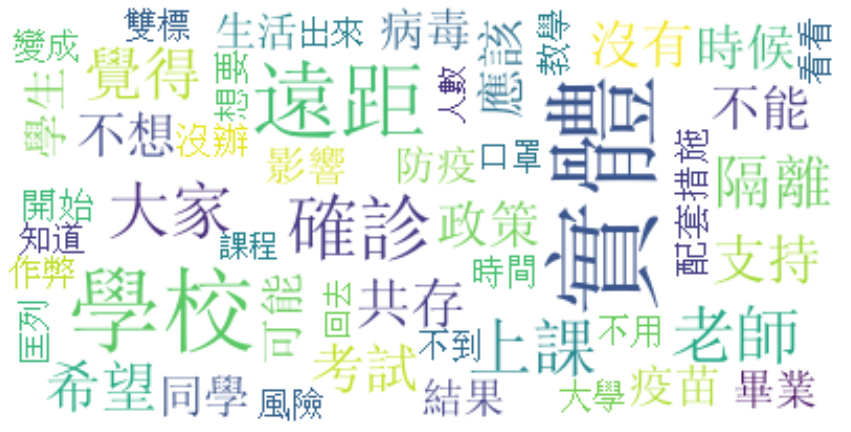

In [50]:
wordcloud = WordCloud(background_color="white", max_words=50, font_path="simsun.ttf")  ##做中文時務必加上字形檔
wordcloud.generate_from_frequencies(frequencies=Counter(term))
plt.figure(figsize=(15,15))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [51]:
##把關鍵詞取出來放入list裡
term = []
for i in df[df_long_distance_rank]["rank"] :
    term.extend(i.split())

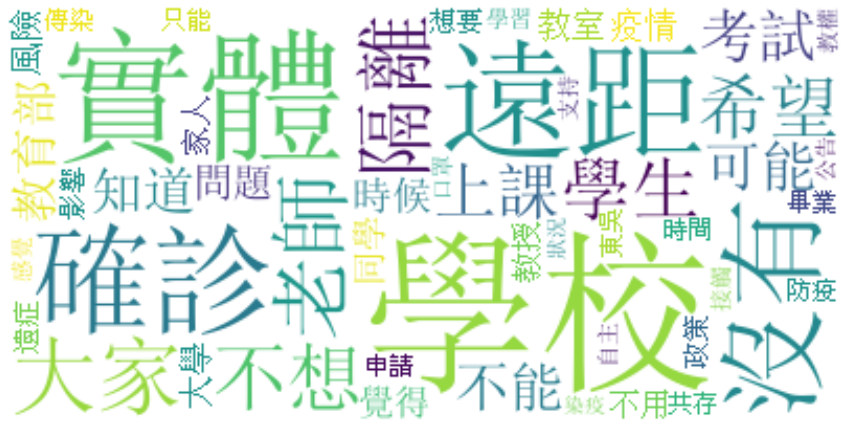

In [52]:
wordcloud = WordCloud(background_color="white", max_words=50, font_path="simsun.ttf")  ##做中文時務必加上字形檔
wordcloud.generate_from_frequencies(frequencies=Counter(term))
plt.figure(figsize=(15,15))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [53]:
df_faction

,faction,count
0,其他,1384
1,遠距,559
2,實體,203


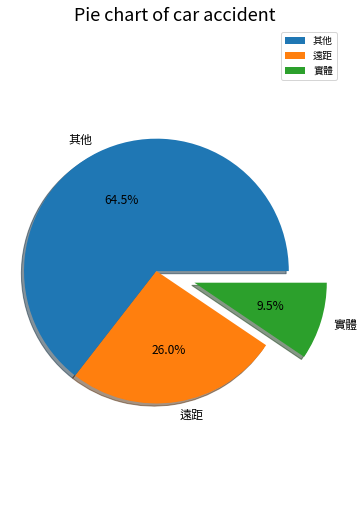

In [54]:
plt.figure(figsize=(6,9))    # 顯示圖框架大小

labels = df_faction["faction"]      # 製作圓餅圖的類別標籤
separeted = (0, 0, 0.3)                  # 依據類別數量，分別設定要突出的區塊
size = df_faction["count"]                         # 製作圓餅圖的數值來源

plt.pie(size,                           # 數值
        labels = labels,                # 標籤
        autopct = "%1.1f%%",            # 將數值百分比並留到小數點一位
        explode = separeted,            # 設定分隔的區塊位置
        pctdistance = 0.6,              # 數字距圓心的距離
        textprops = {"fontsize" : 12},  # 文字大小
        shadow=True)                    # 設定陰影

 
plt.axis('equal')                                          # 使圓餅圖比例相等
plt.title("Pie chart of car accident", {"fontsize" : 18})  # 設定標題及其文字大小
plt.legend(loc = "best")                                   # 設定圖例及其位置為最佳

plt.savefig("Pie chart of car accident.jpg",   # 儲存圖檔
            bbox_inches='tight',               # 去除座標軸占用的空間
            pad_inches=0.0)                    # 去除所有白邊
#plt.close()      # 關閉圖表